In [1]:
# import splitfolders
# splitfolders.ratio('.\Data\dataset\data', output= 'Data', seed= 1337, ratio=(.8,0.1,0.1))

In [3]:
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

Challenges

1. Cleaning the dataset due to following :

* A lot of misspelled labels.
* Overwhelming number of raw images not related to any class.

2. Training model without bias :

* Similarly looking items with common attributes (Fried samosa and pakode looks familiar.)
* Multiple labels clashing together (Butter Naan and Dal Makhni in one picture, Samosa and Pakode, etc.)
* Unwanted feature selection because of big architectures in transfer learning (Ketchup and green chutney is most common thing alongside pakode, samosa, kathi rolls and what not.)


In [7]:
img = plt.imread('Data/train/chole_bhature/015.JPG')
dims = np.shape(img)
dims

(1200, 1600, 3)

In [14]:
matrix = np.reshape(img, (dims[0]*dims[1], dims[2]))
matrix.shape

(1920000, 3)

Image Shape:- (1200, 1600)
Color Channels:- 3
Min Color Depth : 0, Max Color Depth 255


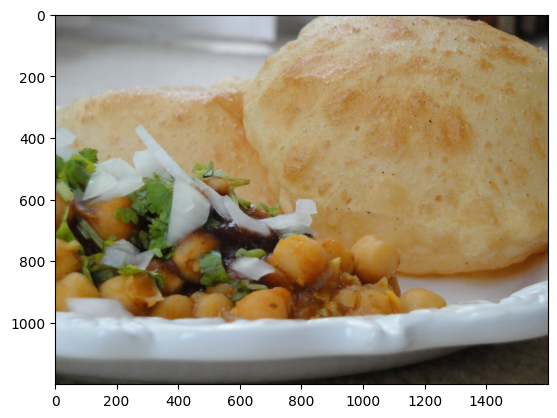

In [9]:
plt.imshow(img)
print("Image Shape:-" , dims[:2])
print("Color Channels:-", dims[2])
print("Min Color Depth : {}, Max Color Depth {}".format(np.min(img) , np.max(img)))

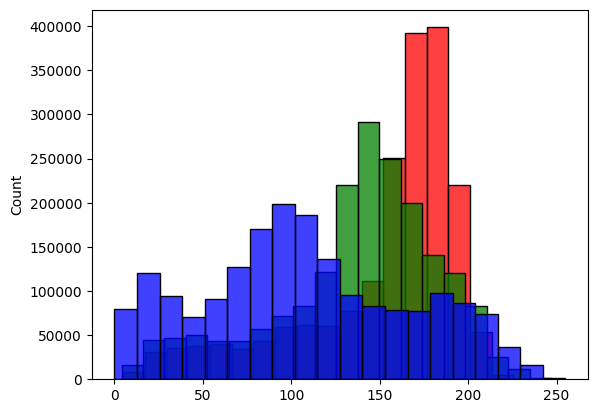

In [19]:
sns.histplot(matrix[:,0], bins=20,color="red")
sns.histplot(matrix[:,1], bins=20,color="green")
sns.histplot(matrix[:,2], bins=20,color="blue")
plt.show()

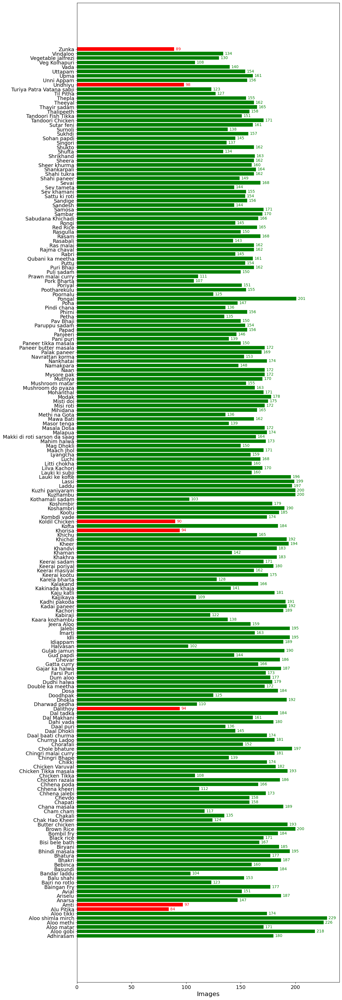

In [10]:
import os

train = 'FoodyMood'

data = dict()

for i in os.listdir(train):
    sub_dir = os.path.join(train , i)
    count = len(os.listdir(sub_dir))
    data[i] = count

keys = data.keys()
values = data.values()

colors = ["red" if x<= 100 else "green" for x in values]

fig , ax = plt.subplots(figsize = (12,45))
y_pos = np.arange(len(values))
plt.barh(y_pos , values , align = "center" , color=colors)
for i , v in enumerate(values):
    ax.text(v+1.4 , i-0.25 , str(v), color = colors[i])
ax.set_yticks(y_pos)
ax.set_yticklabels(keys)
ax.set_xlabel('Images',fontsize=16)
plt.xticks(color='black',fontsize=13)
plt.yticks(fontsize=13)
plt.show()  

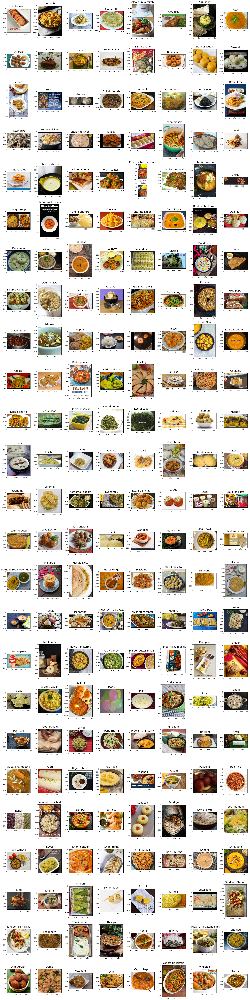

In [15]:
import random

train_folder = "FoodyMood"
images = []

for food_folder in sorted(os.listdir(train_folder)):
    food_items = os.listdir(train_folder + "/" + food_folder)
    food_selected = np.random.choice(food_items)
    images.append(os.path.join(train_folder , food_folder , food_selected))
    
    
fig = plt.figure(1 , figsize = (25,100))
for subplot , image_ in enumerate(images):
    category = image_.split("\\")[1]
    imgs = plt.imread(image_)
    a ,b, c = imgs.shape
    fig = plt.subplot( 25, 8 , subplot+1)
    fig.set_title(category , pad = 10 , size = 18)
    plt.imshow(imgs)
    
plt.tight_layout()